In [1]:
!pip3 install scikit-learn --upgrade --quiet

In [2]:
!pip3 install opendatasets --upgrade --quiet
# kaggle dan veri seti yüklemek için opendatasets i import ettik

In [3]:
import opendatasets as od
od.version() # od nin version kontrolunu yaptık 

'0.1.22'

In [4]:
dataset_url = 'https://www.kaggle.com/jsphyg/weather-dataset-rattle-package' 
# ihtiyacımız olan data url ini kullanabilmek için bir değişkene atadık.

In [5]:
od.download(dataset_url)
# opendatasets in download fonksiyonu ile data mızı indirdik

Skipping, found downloaded files in "./weather-dataset-rattle-package" (use force=True to force download)


In [3]:
import os
# pyhton da işletim sistemi ile ilgili belirli işlemler yapmamaızı sağlarlistdir buna örnek

In [4]:
data_dir = './weather-dataset-rattle-package'
# bura da da listdir fonksiyonu ile liste alabilmek için öncelikle değişekene değer ataması yaptık böylece dosya ve değerlerine ulaşabiliriz

In [5]:
os.listdir(data_dir)
# o dizindeki tüm dosya ve dizinlerin bir listesini döndürür

['weatherAUS.csv']

In [6]:
train_csv = data_dir + '/weatherAUS.csv'
# listdir sayesinde dataset in csv dosyasını okuduk ve tam dosya adını öğrendik (veya olup olmadığını dosyanın)
# daha sonrasında bu dosya üzerinde işlem yapabilmek için gereken tam yolu datadir ve csv yi birleştirerek verdik


In [10]:
!pip install pandas --quiet
#burada pandas ı yüklüyoruz tek fark --quiet o da yükleme işlemi ile ilgili oluşacak bilgi çıktılarını minimum tutmak için kullanılıyor

In [11]:
#import ettik pandas ı kullanabilmek için
import pandas as pd

In [12]:
raw_df = pd.read_csv(train_csv)
# yüklediğimiz dataseti train_csv yi raw_df e yani dataframe ayrıca read_csv fonksiyonu ile okuduk  pandas kütüphanesi ile 

In [13]:
raw_df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [14]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [15]:
raw_df.dropna(subset=['RainToday', 'RainTomorrow'], inplace=True)

# null değerlerimiz var ve amacımız raintomorrow un değerleri olduğu için ilgili bu
#2 kolonu dropna fonksiyonunun subset parametresiyle bu kolonlarda düşürme işlemi yapmak istiyorum dedik

In [16]:
!pip3 install plotly matplotlib seaborn --quiet
# seaborn kütüphanesini yükledik bu da tablo çiziminde kullanılır ısı haritası gibi 

In [17]:
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline 
#plot la çizilmiş tabloların jupyhter de doğrudan kolay görünmesini sağlar
# gerekli kütüphanelerin import edilmesi
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [18]:
px.histogram(raw_df, x='Location', title='Location vs. Rainy Days', color='RainToday')

In [19]:
px.histogram(raw_df, 
             x='Temp3pm', 
             title='Temperature at 3 pm vs. Rain Tomorrow', 
             color='RainTomorrow')

In [20]:
px.histogram(raw_df, 
             x='RainTomorrow', 
             color='RainToday', 
             title='Rain Tomorrow vs. Rain Today')

In [21]:
px.scatter(raw_df.sample(2000), 
           title='Min Temp. vs Max Temp.',
           x='MinTemp', 
           y='MaxTemp', 
           color='RainToday')

In [22]:
px.scatter(raw_df.sample(2000), 
           title='Temp (3 pm) vs. Humidity (3 pm)',
           x='Temp3pm',
           y='Humidity3pm',
           color='RainTomorrow')

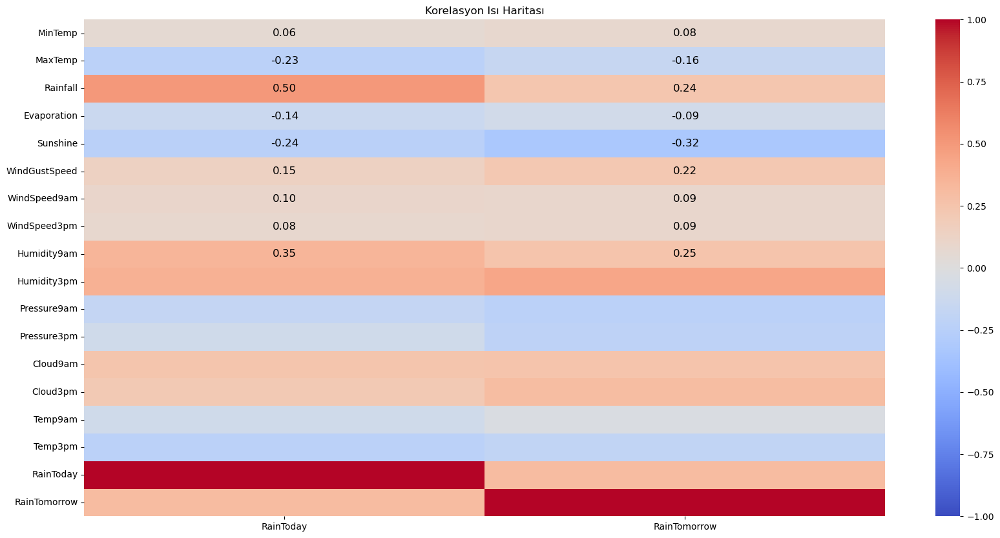

In [7]:
import pandas as pd
from sklearn.impute import SimpleImputer
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Örnek veri yükleme
raw_df = pd.read_csv(train_csv) # uygun okuma komutu

# Verileri dönüştür
raw_df['RainToday'] = raw_df['RainToday'].map({'No': 0, 'Yes': 1})
raw_df['RainTomorrow'] = raw_df['RainTomorrow'].map({'No': 0, 'Yes': 1})

# Eksik değerler ile başa çıkmak için SimpleImputer kullanma
# Sayısal sütunları seç
numerical_cols = raw_df.select_dtypes(include=np.number).columns

# SimpleImputer ile eksik değerleri ortalama ile doldur
imputer = SimpleImputer(strategy='mean')
raw_df[numerical_cols] = imputer.fit_transform(raw_df[numerical_cols])

# Korelasyon matrisini hesapla
correlation_matrix = raw_df[numerical_cols].corr()
correlation_with_rain = correlation_matrix[['RainToday', 'RainTomorrow']]

# Isı haritası
plt.figure(figsize=(20, 10))
sns.heatmap(correlation_with_rain, annot=True, fmt=".2f", cmap='coolwarm', vmin=-1, vmax=1, annot_kws={"size": 12, "color": 'black'})
plt.title('Korelasyon Isı Haritası')
plt.show()

Bugün ki yağmur için yağmurun düşüşü etkili
yarın ki yağmur için saat 3 te ki nem etkili
Her iki gün içinde güneş ışığı ters etkili

In [24]:
use_sample = False

In [25]:
sample_fraction = 0.1

In [26]:
if use_sample:
    raw_df = raw_df.sample(frac=sample_fraction).copy()

In [27]:
!pip install scikit-learn --upgrade --quiet

In [28]:
from sklearn.model_selection import train_test_split

In [29]:
train_and_val_df, test_df = train_test_split(raw_df, test_size=0.2, random_state=42)
train_df, val_df = train_test_split(train_and_val_df, test_size=0.25, random_state=42)

In [30]:
print('train_df.shape :', train_df.shape)
print('val_df.shape :', val_df.shape)
print('test_df.shape :', test_df.shape)

train_df.shape : (87276, 23)
val_df.shape : (29092, 23)
test_df.shape : (29092, 23)


<Axes: title={'center': 'No. of Rows per Year'}, xlabel='Date', ylabel='count'>

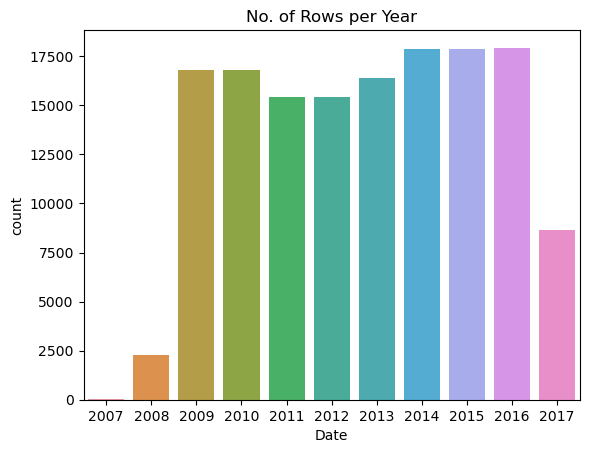

In [8]:
plt.title('No. of Rows per Year')
sns.countplot(x=pd.to_datetime(raw_df.Date).dt.year)

In [32]:
year = pd.to_datetime(raw_df.Date).dt.year

train_df = raw_df[year < 2015]
val_df = raw_df[year == 2015]
test_df = raw_df[year > 2015]

In [33]:
print('train_df.shape :', train_df.shape)
print('val_df.shape :', val_df.shape)
print('test_df.shape :', test_df.shape)

train_df.shape : (101018, 23)
val_df.shape : (17885, 23)
test_df.shape : (26557, 23)


In [34]:
train_df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,5.468232,7.611178,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.000000,4.50993,16.9,21.8,0.0,0.0
1,2008-12-02,Albury,7.4,25.1,0.0,5.468232,7.611178,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,4.447461,4.50993,17.2,24.3,0.0,0.0
2,2008-12-03,Albury,12.9,25.7,0.0,5.468232,7.611178,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,4.447461,2.00000,21.0,23.2,0.0,0.0
3,2008-12-04,Albury,9.2,28.0,0.0,5.468232,7.611178,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,4.447461,4.50993,18.1,26.5,0.0,0.0
4,2008-12-05,Albury,17.5,32.3,1.0,5.468232,7.611178,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.000000,8.00000,17.8,29.7,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144548,2014-12-27,Uluru,16.9,33.2,0.0,5.468232,7.611178,SSE,43.0,ESE,...,22.0,13.0,1014.1,1009.8,4.447461,4.50993,23.7,31.8,0.0,0.0
144549,2014-12-28,Uluru,15.1,36.8,0.0,5.468232,7.611178,NE,31.0,ENE,...,16.0,8.0,1012.6,1007.6,4.447461,4.50993,28.9,34.8,0.0,0.0
144550,2014-12-29,Uluru,17.3,37.8,0.0,5.468232,7.611178,ESE,39.0,ESE,...,15.0,8.0,1011.9,1008.0,4.447461,4.50993,29.7,35.7,0.0,0.0
144551,2014-12-30,Uluru,20.1,38.5,0.0,5.468232,7.611178,ESE,43.0,ESE,...,22.0,9.0,1014.0,1009.2,4.447461,4.50993,29.8,37.2,0.0,0.0


In [35]:
val_df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
2133,2015-01-01,Albury,11.4,33.5,0.0,5.468232,7.611178,WSW,30.0,ESE,...,45.0,14.0,1013.5,1011.0,4.447461,4.50993,21.0,32.7,0.0,0.0
2134,2015-01-02,Albury,15.5,39.6,0.0,5.468232,7.611178,NE,56.0,ESE,...,45.0,12.0,1016.0,1012.4,4.447461,4.50993,25.6,38.2,0.0,0.0
2135,2015-01-03,Albury,17.1,38.3,0.0,5.468232,7.611178,NNE,48.0,NE,...,35.0,19.0,1017.9,1012.3,4.447461,4.50993,29.2,37.0,0.0,0.0
2136,2015-01-04,Albury,26.0,33.1,0.0,5.468232,7.611178,NNE,41.0,ESE,...,46.0,37.0,1013.6,1012.1,8.000000,5.00000,27.4,30.9,0.0,0.0
2137,2015-01-05,Albury,19.0,35.2,0.0,5.468232,7.611178,E,33.0,SSE,...,60.0,34.0,1017.4,1014.7,8.000000,4.50993,25.6,32.5,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144913,2015-12-27,Uluru,20.5,34.7,0.0,5.468232,7.611178,E,52.0,ESE,...,23.0,12.0,1013.2,1010.1,4.447461,4.50993,24.3,33.0,0.0,0.0
144914,2015-12-28,Uluru,18.0,36.4,0.0,5.468232,7.611178,ESE,54.0,E,...,17.0,7.0,1014.7,1010.9,4.447461,4.50993,26.7,35.0,0.0,0.0
144915,2015-12-29,Uluru,17.5,37.1,0.0,5.468232,7.611178,E,56.0,E,...,12.0,7.0,1012.6,1007.5,4.447461,4.50993,28.1,34.7,0.0,0.0
144916,2015-12-30,Uluru,20.0,38.9,0.0,5.468232,7.611178,E,59.0,E,...,12.0,12.0,1007.2,1002.6,4.447461,1.00000,31.3,38.4,0.0,0.0


In [36]:
test_df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
2498,2016-01-01,Albury,20.4,37.600000,0.0,5.468232,7.611178,ENE,54.00000,NaN,...,46.0,17.0,1013.4,1009.2,7.000000,3.00000,26.1,36.7,0.0,0.000000
2499,2016-01-02,Albury,20.9,33.600000,0.4,5.468232,7.611178,SSE,50.00000,SSE,...,54.0,30.0,1011.1,1008.4,8.000000,8.00000,24.8,31.7,0.0,1.000000
2500,2016-01-03,Albury,18.4,23.100000,2.2,5.468232,7.611178,ENE,48.00000,ESE,...,62.0,67.0,1014.0,1014.8,8.000000,8.00000,21.8,19.5,1.0,1.000000
2501,2016-01-04,Albury,17.3,23.700000,15.6,5.468232,7.611178,SSE,39.00000,SE,...,74.0,65.0,1017.9,1016.5,8.000000,8.00000,19.2,21.6,1.0,1.000000
2502,2016-01-05,Albury,15.5,22.900000,6.8,5.468232,7.611178,ENE,31.00000,SE,...,92.0,63.0,1016.3,1013.9,8.000000,8.00000,17.2,22.2,1.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2017-06-21,Uluru,2.8,23.400000,0.0,5.468232,7.611178,E,31.00000,SE,...,51.0,24.0,1024.6,1020.3,4.447461,4.50993,10.1,22.4,0.0,0.000000
145456,2017-06-22,Uluru,3.6,25.300000,0.0,5.468232,7.611178,NNW,22.00000,SE,...,56.0,21.0,1023.5,1019.1,4.447461,4.50993,10.9,24.5,0.0,0.000000
145457,2017-06-23,Uluru,5.4,26.900000,0.0,5.468232,7.611178,N,37.00000,SE,...,53.0,24.0,1021.0,1016.8,4.447461,4.50993,12.5,26.1,0.0,0.000000
145458,2017-06-24,Uluru,7.8,27.000000,0.0,5.468232,7.611178,SE,28.00000,SSE,...,51.0,24.0,1019.4,1016.5,3.000000,2.00000,15.1,26.0,0.0,0.000000


In [37]:
input_cols = list(train_df.columns)[1:-1] # kolon listenin ilk elemanından sonraki elemanında son elemanından öncekine kadar  
target_col = 'RainTomorrow'

In [38]:
print(input_cols)

['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainToday']


In [39]:
target_col

'RainTomorrow'

In [40]:
train_inputs = train_df[input_cols].copy()
train_targets = train_df[target_col].copy()

In [41]:
val_inputs = val_df[input_cols].copy()
val_targets = val_df[target_col].copy()

In [42]:
test_inputs = test_df[input_cols].copy()
test_targets = test_df[target_col].copy()

In [43]:
train_inputs

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
0,Albury,13.4,22.9,0.6,5.468232,7.611178,W,44.0,W,WNW,...,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.50993,16.9,21.8,0.0
1,Albury,7.4,25.1,0.0,5.468232,7.611178,WNW,44.0,NNW,WSW,...,22.0,44.0,25.0,1010.6,1007.8,4.447461,4.50993,17.2,24.3,0.0
2,Albury,12.9,25.7,0.0,5.468232,7.611178,WSW,46.0,W,WSW,...,26.0,38.0,30.0,1007.6,1008.7,4.447461,2.00000,21.0,23.2,0.0
3,Albury,9.2,28.0,0.0,5.468232,7.611178,NE,24.0,SE,E,...,9.0,45.0,16.0,1017.6,1012.8,4.447461,4.50993,18.1,26.5,0.0
4,Albury,17.5,32.3,1.0,5.468232,7.611178,W,41.0,ENE,NW,...,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.00000,17.8,29.7,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144548,Uluru,16.9,33.2,0.0,5.468232,7.611178,SSE,43.0,ESE,SSE,...,26.0,22.0,13.0,1014.1,1009.8,4.447461,4.50993,23.7,31.8,0.0
144549,Uluru,15.1,36.8,0.0,5.468232,7.611178,NE,31.0,ENE,SW,...,20.0,16.0,8.0,1012.6,1007.6,4.447461,4.50993,28.9,34.8,0.0
144550,Uluru,17.3,37.8,0.0,5.468232,7.611178,ESE,39.0,ESE,SSE,...,9.0,15.0,8.0,1011.9,1008.0,4.447461,4.50993,29.7,35.7,0.0
144551,Uluru,20.1,38.5,0.0,5.468232,7.611178,ESE,43.0,ESE,SSW,...,17.0,22.0,9.0,1014.0,1009.2,4.447461,4.50993,29.8,37.2,0.0


In [44]:
train_targets

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
144548    0.0
144549    0.0
144550    0.0
144551    0.0
144552    0.0
Name: RainTomorrow, Length: 101018, dtype: float64

In [45]:
!pip install numpy --quiet

In [46]:
import numpy as np

In [47]:
numeric_cols = train_inputs.select_dtypes(include=np.number).columns.tolist() # include parametresi anlaşılıyor ama araştır ...
categorical_cols = train_inputs.select_dtypes('object').columns.tolist() # sayısal olmayan tüm alanların tipi object gözüküyor. 

In [48]:
train_inputs[numeric_cols].describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,101018.0,11.993708,6.313387,-8.5,7.5,11.800000,16.500000,33.9
MaxTemp,101018.0,22.982556,6.975608,-4.1,17.9,22.400000,27.800000,48.1
Rainfall,101018.0,2.381165,8.432540,0.0,0.0,0.000000,1.000000,371.0
Evaporation,101018.0,5.353008,3.108422,0.0,3.8,5.468232,5.468232,82.4
Sunshine,101018.0,7.601115,2.897064,0.0,7.5,7.611178,9.200000,14.3
WindGustSpeed,101018.0,40.248486,13.201832,6.0,31.0,39.000000,46.000000,135.0
WindSpeed9am,101018.0,14.126682,8.943325,0.0,7.0,13.000000,19.000000,87.0
WindSpeed3pm,101018.0,18.776147,8.817635,0.0,13.0,19.000000,24.000000,87.0
Humidity9am,101018.0,68.697168,18.831528,0.0,57.0,69.000000,83.000000,100.0
Humidity3pm,101018.0,51.552246,20.584602,0.0,37.0,52.000000,65.000000,100.0


In [49]:
train_inputs[categorical_cols].nunique()

Location       49
WindGustDir    16
WindDir9am     16
WindDir3pm     16
dtype: int64

In [50]:
from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer
# simpleimputer basit yöntemlerle doldurma yaparken knnimputer en yakın komşularının değerleriyle doldurur

In [51]:
imputer = SimpleImputer(strategy = 'mean')
knn_imputer = KNNImputer(n_neighbors=2)
# burada komşu olarak 2 adet yakın komşuna bak ve bu o komşyuların değerlerini al dedik

In [52]:
raw_df[numeric_cols].isna().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
dtype: int64

In [53]:
train_inputs[numeric_cols].isna().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
dtype: int64

In [54]:
imputer.fit(raw_df[numeric_cols])
knn_imputer.fit(raw_df[numeric_cols])
#knn den ürettiğimizimputer a fit et diyoruz numeric_cols ları 

KNNImputer(n_neighbors=2)

In [55]:
list(imputer.statistics_)

[12.19403438096892,
 23.221348275646854,
 2.3609181499166656,
 5.468231522922463,
 7.611177520661158,
 40.03523007167319,
 14.043425914971499,
 18.662656778887342,
 68.88083133761887,
 51.5391158755046,
 1017.6499397983052,
 1015.2558888309619,
 4.447461260215246,
 4.509930082924905,
 16.990631415587398,
 21.683390318009742,
 0.22419285648984874]

In [56]:
train_inputs[numeric_cols] = imputer.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = imputer.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = imputer.transform(test_inputs[numeric_cols])

In [57]:
train_inputs[numeric_cols].isna().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
dtype: int64

In [58]:
raw_df[numeric_cols].describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,145460.0,12.194034,6.365750,-8.5,7.700000,12.100000,16.800000,33.9
MaxTemp,145460.0,23.221348,7.088124,-4.8,18.000000,22.700000,28.200000,48.1
Rainfall,145460.0,2.360918,8.382488,0.0,0.000000,0.000000,1.000000,371.0
Evaporation,145460.0,5.468232,3.161541,0.0,4.000000,5.468232,5.468232,145.0
Sunshine,145460.0,7.611178,2.729486,0.0,7.611178,7.611178,8.700000,14.5
WindGustSpeed,145460.0,40.035230,13.118253,6.0,31.000000,39.000000,46.000000,135.0
WindSpeed9am,145460.0,14.043426,8.861059,0.0,7.000000,13.000000,19.000000,130.0
WindSpeed3pm,145460.0,18.662657,8.716581,0.0,13.000000,18.662657,24.000000,87.0
Humidity9am,145460.0,68.880831,18.854765,0.0,57.000000,69.000000,83.000000,100.0
Humidity3pm,145460.0,51.539116,20.471189,0.0,37.000000,51.539116,65.000000,100.0


In [59]:
from sklearn.preprocessing import MinMaxScaler

In [60]:
scaler = MinMaxScaler()

In [61]:
scaler.fit(raw_df[numeric_cols])

MinMaxScaler()

In [62]:
print('Minimum:')
print(numeric_cols)
print(list(scaler.data_min_))


Minimum:
['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainToday']
[-8.5, -4.8, 0.0, 0.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 980.5, 977.1, 0.0, 0.0, -7.2, -5.4, 0.0]


In [63]:
print('Maximum:')
list(scaler.data_max_)

Maximum:


[33.9,
 48.1,
 371.0,
 145.0,
 14.5,
 135.0,
 130.0,
 87.0,
 100.0,
 100.0,
 1041.0,
 1039.6,
 9.0,
 9.0,
 40.2,
 46.7,
 1.0]

In [64]:
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [65]:
train_inputs[numeric_cols].describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,101018.0,0.483342,0.148901,0.000000,0.377358,0.478774,0.589623,1.000000
MaxTemp,101018.0,0.525190,0.131864,0.013233,0.429112,0.514178,0.616257,1.000000
Rainfall,101018.0,0.006418,0.022729,0.000000,0.000000,0.000000,0.002695,1.000000
Evaporation,101018.0,0.036917,0.021437,0.000000,0.026207,0.037712,0.037712,0.568276
Sunshine,101018.0,0.524215,0.199797,0.000000,0.517241,0.524909,0.634483,0.986207
WindGustSpeed,101018.0,0.265492,0.102340,0.000000,0.193798,0.255814,0.310078,1.000000
WindSpeed9am,101018.0,0.108667,0.068795,0.000000,0.053846,0.100000,0.146154,0.669231
WindSpeed3pm,101018.0,0.215818,0.101352,0.000000,0.149425,0.218391,0.275862,1.000000
Humidity9am,101018.0,0.686972,0.188315,0.000000,0.570000,0.690000,0.830000,1.000000
Humidity3pm,101018.0,0.515522,0.205846,0.000000,0.370000,0.520000,0.650000,1.000000


In [66]:
raw_df[categorical_cols].nunique()

Location       49
WindGustDir    16
WindDir9am     16
WindDir3pm     16
dtype: int64

In [67]:
from sklearn.preprocessing import OneHotEncoder

In [68]:
def birlestir(x, y):
    return "softito" + str(x) + str(y)
encoder = OneHotEncoder(sparse_output = False, handle_unknown = 'ignore', feature_name_combiner = birlestir)

In [69]:
encoder.fit(raw_df[categorical_cols])

OneHotEncoder(feature_name_combiner=<function birlestir at 0x17f5faca0>,
              handle_unknown='ignore', sparse_output=False)

In [70]:
encoder.categories_
# categorical_cols

[array(['Adelaide', 'Albany', 'Albury', 'AliceSprings', 'BadgerysCreek',
        'Ballarat', 'Bendigo', 'Brisbane', 'Cairns', 'Canberra', 'Cobar',
        'CoffsHarbour', 'Dartmoor', 'Darwin', 'GoldCoast', 'Hobart',
        'Katherine', 'Launceston', 'Melbourne', 'MelbourneAirport',
        'Mildura', 'Moree', 'MountGambier', 'MountGinini', 'Newcastle',
        'Nhil', 'NorahHead', 'NorfolkIsland', 'Nuriootpa', 'PearceRAAF',
        'Penrith', 'Perth', 'PerthAirport', 'Portland', 'Richmond', 'Sale',
        'SalmonGums', 'Sydney', 'SydneyAirport', 'Townsville',
        'Tuggeranong', 'Uluru', 'WaggaWagga', 'Walpole', 'Watsonia',
        'Williamtown', 'Witchcliffe', 'Wollongong', 'Woomera'],
       dtype=object),
 array(['E', 'ENE', 'ESE', 'N', 'NE', 'NNE', 'NNW', 'NW', 'S', 'SE', 'SSE',
        'SSW', 'SW', 'W', 'WNW', 'WSW', nan], dtype=object),
 array(['E', 'ENE', 'ESE', 'N', 'NE', 'NNE', 'NNW', 'NW', 'S', 'SE', 'SSE',
        'SSW', 'SW', 'W', 'WNW', 'WSW', nan], dtype=object),
 ar

In [71]:
encoded_cols = list(encoder.get_feature_names_out(categorical_cols))
encoded_cols

['softitoLocationAdelaide',
 'softitoLocationAlbany',
 'softitoLocationAlbury',
 'softitoLocationAliceSprings',
 'softitoLocationBadgerysCreek',
 'softitoLocationBallarat',
 'softitoLocationBendigo',
 'softitoLocationBrisbane',
 'softitoLocationCairns',
 'softitoLocationCanberra',
 'softitoLocationCobar',
 'softitoLocationCoffsHarbour',
 'softitoLocationDartmoor',
 'softitoLocationDarwin',
 'softitoLocationGoldCoast',
 'softitoLocationHobart',
 'softitoLocationKatherine',
 'softitoLocationLaunceston',
 'softitoLocationMelbourne',
 'softitoLocationMelbourneAirport',
 'softitoLocationMildura',
 'softitoLocationMoree',
 'softitoLocationMountGambier',
 'softitoLocationMountGinini',
 'softitoLocationNewcastle',
 'softitoLocationNhil',
 'softitoLocationNorahHead',
 'softitoLocationNorfolkIsland',
 'softitoLocationNuriootpa',
 'softitoLocationPearceRAAF',
 'softitoLocationPenrith',
 'softitoLocationPerth',
 'softitoLocationPerthAirport',
 'softitoLocationPortland',
 'softitoLocationRichmond',

In [72]:
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
len(train_inputs)

/var/folders/kb/3fvtw5x50w31_7jqmvf1_kfm0000gn/T/ipykernel_2555/1884085614.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/kb/3fvtw5x50w31_7jqmvf1_kfm0000gn/T/ipykernel_2555/1884085614.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/kb/3fvtw5x50w31_7jqmvf1_kfm0000gn/T/ipykernel_2555/1884085614.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.conca

101018

In [73]:
val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical_cols])
len(val_inputs)

/var/folders/kb/3fvtw5x50w31_7jqmvf1_kfm0000gn/T/ipykernel_2555/1368070834.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/kb/3fvtw5x50w31_7jqmvf1_kfm0000gn/T/ipykernel_2555/1368070834.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/kb/3fvtw5x50w31_7jqmvf1_kfm0000gn/T/ipykernel_2555/1368070834.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.conca

17885

In [74]:
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical_cols])
len(test_inputs)

/var/folders/kb/3fvtw5x50w31_7jqmvf1_kfm0000gn/T/ipykernel_2555/3719028968.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/kb/3fvtw5x50w31_7jqmvf1_kfm0000gn/T/ipykernel_2555/3719028968.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/kb/3fvtw5x50w31_7jqmvf1_kfm0000gn/T/ipykernel_2555/3719028968.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.conca

26557

In [75]:
pd.set_option('display.max_columns', None)

In [76]:
test_inputs.T

,2498,2499,2500,2501,2502,2503,2504,2505,2506,2507,2508,2509,2510,2511,2512,2513,2514,2515,2516,2517,2518,2519,2520,2521,2522,2523,2524,2525,2526,2527,2528,2529,2530,2531,2532,2533,2534,2535,2536,2537,2538,2539,2540,2541,2542,2543,2544,2545,2546,2547,2548,2549,2550,2551,2552,2553,2554,2555,2556,2557,2558,2559,2560,2561,2562,2563,2564,2565,2566,2567,2568,2569,2570,2571,2572,2573,2574,2575,2576,2577,2578,2579,2580,2581,2582,2583,2584,2585,2586,2587,2588,2589,2590,2591,2592,2593,2594,2595,2596,2597,2598,2599,2600,2601,2602,2603,2604,2605,2606,2607,2608,2609,2610,2611,2612,2613,2614,2615,2616,2617,2618,2619,2620,2621,2622,2623,2624,2625,2626,2627,2628,2629,2630,2631,2632,2633,2634,2635,2636,2637,2638,2639,2640,2641,2642,2643,2644,2645,2646,2647,2648,2649,2650,2651,2652,2653,2654,2655,2656,2657,2658,2659,2660,2661,2662,2663,2664,2665,2666,2667,2668,2669,2670,2671,2672,2673,2674,2675,2676,2677,2678,2679,2680,2681,2682,2683,2684,2685,2686,2687,2688,2689,2690,2691,2692,2693,2694,2695,2696,2697,2698,2699,2700,2701,2702,2703,2704,2705,2706,2707,2708,2709,2710,2711,2712,2713,2714,2715,2716,2717,2718,2719,2720,2721,2722,2723,2724,2725,2726,2727,2728,2729,2730,2731,2732,2733,2734,2735,2736,2737,2738,2739,2740,2741,2742,2743,2744,2745,2746,2747,2748,2749,2750,2751,2752,2753,2754,2755,2756,2757,2758,2759,2760,2761,2762,2763,2764,2765,2766,2767,2768,2769,2770,2771,2772,2773,2774,2775,2776,2777,2778,2779,2780,2781,2782,2783,2784,2785,2786,2787,2788,2789,2790,2791,2792,2793,2794,2795,2796,2797,2798,2799,2800,2801,2802,2803,2804,2805,2806,2807,2808,2809,2810,2811,2812,2813,2814,2815,2816,2817,2818,2819,2820,2821,2822,2823,2824,2825,2826,2827,2828,2829,2830,2831,2832,2833,2834,2835,2836,2837,2838,2839,2840,2841,2842,2843,2844,2845,2846,2847,2848,2849,2850,2851,2852,2853,2854,2855,2856,2857,2858,2859,2860,2861,2862,2863,2864,2865,2866,2867,2868,2869,2870,2871,2872,2873,2874,2875,2876,2877,2878,2879,2880,2881,2882,2883,2884,2885,2886,2887,2888,2889,2890,2891,2892,2893,2894,2895,2896,2897,2898,2899,2900,2901,2902,2903,2904,2905,2906,2907,2908,2909,2910,2911,2912,2913,2914,2915,2916,2917,2918,2919,2920,2921,2922,2923,2924,2925,2926,2927,2928,2929,2930,2931,2932,2933,2934,2935,2936,2937,2938,2939,2940,2941,2942,2943,2944,2945,2946,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2958,2959,2960,2961,2962,2963,2964,2965,2966,2967,2968,2969,2970,2971,2972,2973,2974,2975,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986,2987,2988,2989,2990,2991,2992,2993,2994,2995,2996,2997,2998,2999,3000,3001,3002,3003,3004,3005,3006,3007,3008,3009,3010,3011,3012,3013,3014,3015,3016,3017,3018,3019,3020,3021,3022,3023,3024,3025,3026,3027,3028,3029,3030,3031,3032,3033,3034,3035,3036,3037,3038,3039,5507,5508,5509,5510,5511,5512,5513,5514,5515,5516,5517,5518,5519,5520,5521,5522,5523,5524,5525,5526,5527,5528,5529,5530,5531,5532,5533,5534,5535,5536,5537,5538,5539,5540,5541,5542,5543,5544,5545,5546,5547,5548,5549,5550,5551,5552,5553,5554,5555,5556,5557,5558,5559,5560,5561,5562,5563,5564,5565,5566,5567,5568,5569,5570,5571,5572,5573,5574,5575,5576,5577,5578,5579,5580,5581,5582,5583,5584,5585,5586,5587,5588,5589,5590,5591,5592,5593,5594,5595,5596,5597,5598,5599,5600,5601,5602,5603,5604,5605,5606,5607,5608,5609,5610,5611,5612,5613,5614,5615,5616,5617,5618,5619,5620,5621,5622,5623,5624,5625,5626,5627,5628,5629,5630,5631,5632,5633,5634,5635,5636,5637,5638,5639,5640,5641,5642,5643,5644,5645,5646,5647,5648,5649,5650,5651,5652,5653,5654,5655,5656,5657,5658,5659,5660,5661,5662,5663,5664,5665,5666,5667,5668,5669,5670,5671,5672,5673,5674,5675,5676,5677,5678,5679,5680,5681,5682,5683,5684,5685,5686,5687,5688,5689,5690,5691,5692,5693,5694,5695,5696,5697,5698,5699,5700,5701,5702,5703,5704,5705,5706,5707,5708,5709,5710,5711,5712,5713,5714,5715,5716,5717,5718,5719,5720,5721,5722,5723,5724,5725,5726,5727,5728,5729,5730,5731,5732,5733,5734,5735,5736,5737,5738,5739,5740,5741,5742,5743,5744,5745,5746,5747,5748,5749,5750,5751,5752,5753,5754,5755,5756,5757,5758,5759,5760,5761,5762,5763,5764

In [77]:
print('train_inputs:', train_inputs.shape)
print('train_targets:', train_targets.shape)
print('val_inputs:', val_inputs.shape)
print('val_targets:', val_targets.shape)
print('test_inputs:', test_inputs.shape)
print('test_targets:', test_targets.shape)

train_inputs: (101018, 121)
train_targets: (101018,)
val_inputs: (17885, 121)
val_targets: (17885,)
test_inputs: (26557, 121)
test_targets: (26557,)


In [78]:
!pip3 install pyarrow --quiet

In [79]:
train_inputs.to_parquet('train_inputs.parquet')
val_inputs.to_parquet('val_inputs.parquet')
test_inputs.to_parquet('test_inputs.parquet')

In [80]:
%%time
pd.DataFrame(train_targets).to_parquet('train_targets.parquet')
pd.DataFrame(val_targets).to_parquet('val_targets.parquet')
pd.DataFrame(test_targets).to_parquet('test_targets.parquet')

CPU times: user 9.54 ms, sys: 2.31 ms, total: 11.9 ms
Wall time: 14.5 ms


In [81]:
%%time

train_inputs = pd.read_parquet('train_inputs.parquet')
val_inputs = pd.read_parquet('val_inputs.parquet')
test_inputs = pd.read_parquet('test_inputs.parquet')

train_targets = pd.read_parquet('train_targets.parquet')[target_col]
val_targets = pd.read_parquet('val_targets.parquet')[target_col]
test_targets = pd.read_parquet('test_targets.parquet')[target_col]

CPU times: user 127 ms, sys: 68.2 ms, total: 196 ms
Wall time: 116 ms


In [82]:
val_inputs

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,softitoLocationAdelaide,softitoLocationAlbany,softitoLocationAlbury,softitoLocationAliceSprings,softitoLocationBadgerysCreek,softitoLocationBallarat,softitoLocationBendigo,softitoLocationBrisbane,softitoLocationCairns,softitoLocationCanberra,softitoLocationCobar,softitoLocationCoffsHarbour,softitoLocationDartmoor,softitoLocationDarwin,softitoLocationGoldCoast,softitoLocationHobart,softitoLocationKatherine,softitoLocationLaunceston,softitoLocationMelbourne,softitoLocationMelbourneAirport,softitoLocationMildura,softitoLocationMoree,softitoLocationMountGambier,softitoLocationMountGinini,softitoLocationNewcastle,softitoLocationNhil,softitoLocationNorahHead,softitoLocationNorfolkIsland,softitoLocationNuriootpa,softitoLocationPearceRAAF,softitoLocationPenrith,softitoLocationPerth,softitoLocationPerthAirport,softitoLocationPortland,softitoLocationRichmond,softitoLocationSale,softitoLocationSalmonGums,softitoLocationSydney,softitoLocationSydneyAirport,softitoLocationTownsville,softitoLocationTuggeranong,softitoLocationUluru,softitoLocationWaggaWagga,softitoLocationWalpole,softitoLocationWatsonia,softitoLocationWilliamtown,softitoLocationWitchcliffe,softitoLocationWollongong,softitoLocationWoomera,softitoWindGustDirE,softitoWindGustDirENE,softitoWindGustDirESE,softitoWindGustDirN,softitoWindGustDirNE,softitoWindGustDirNNE,softitoWindGustDirNNW,softitoWindGustDirNW,softitoWindGustDirS,softitoWindGustDirSE,softitoWindGustDirSSE,softitoWindGustDirSSW,softitoWindGustDirSW,softitoWindGustDirW,softitoWindGustDirWNW,softitoWindGustDirWSW,softitoWindGustDirnan,softitoWindDir9amE,softitoWindDir9amENE,softitoWindDir9amESE,softitoWindDir9amN,softitoWindDir9amNE,softitoWindDir9amNNE,softitoWindDir9amNNW,softitoWindDir9amNW,softitoWindDir9amS,softitoWindDir9amSE,softitoWindDir9amSSE,softitoWindDir9amSSW,softitoWindDir9amSW,softitoWindDir9amW,softitoWindDir9amWNW,softitoWindDir9amWSW,softitoWindDir9amnan,softitoWindDir3pmE,softitoWindDir3pmENE,softitoWindDir3pmESE,softitoWindDir3pmN,softitoWindDir3pmNE,softitoWindDir3pmNNE,softitoWindDir3pmNNW,softitoWindDir3pmNW,softitoWindDir3pmS,softitoWindDir3pmSE,softitoWindDir3pmSSE,softitoWindDir3pmSSW,softitoWindDir3pmSW,softitoWindDir3pmW,softitoWindDir3pmWNW,softitoWindDir3pmWSW,softitoWindDir3pmnan
2133,Albury,0.469340,0.724008,0.0,0.037712,0.524909,WSW,0.186047,ESE,W,0.053846,0.126437,0.45,0.14,0.545455,0.5424,0.494162,0.501103,0.594937,0.731286,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2134,Albury,0.566038,0.839319,0.0,0.037712,0.524909,NE,0.387597,ESE,ESE,0.069231,0.103448,0.45,0.12,0.586777,0.5648,0.494162,0.501103,0.691983,0.836852,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2135,Albury,0.603774,0.814745,0.0,0.037712,0.524909,NNE,0.325581,NE,N,0.153846,0.229885,0.35,0.19,0.618182,0.5632,0.494162,0.501103,0.767932,0.813820,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

In [83]:
val_targets

2133      0.0
2134      0.0
2135      0.0
2136      0.0
2137      0.0
         ... 
144913    0.0
144914    0.0
144915    0.0
144916    0.0
144917    0.0
Name: RainTomorrow, Length: 17885, dtype: float64

In [103]:
from sklearn.linear_model import LogisticRegression

In [107]:
model = LogisticRegression(solver='liblinear')

In [108]:
model.fit(train_inputs[numeric_cols + encoded_cols], train_targets)

ValueError: Unknown label type: continuous. Maybe you are trying to fit a classifier, which expects discrete classes on a regression target with continuous values.

In [95]:
print(numeric_cols + encoded_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainToday', 'softitoLocationAdelaide', 'softitoLocationAlbany', 'softitoLocationAlbury', 'softitoLocationAliceSprings', 'softitoLocationBadgerysCreek', 'softitoLocationBallarat', 'softitoLocationBendigo', 'softitoLocationBrisbane', 'softitoLocationCairns', 'softitoLocationCanberra', 'softitoLocationCobar', 'softitoLocationCoffsHarbour', 'softitoLocationDartmoor', 'softitoLocationDarwin', 'softitoLocationGoldCoast', 'softitoLocationHobart', 'softitoLocationKatherine', 'softitoLocationLaunceston', 'softitoLocationMelbourne', 'softitoLocationMelbourneAirport', 'softitoLocationMildura', 'softitoLocationMoree', 'softitoLocationMountGambier', 'softitoLocationMountGinini', 'softitoLocationNewcastle', 'softitoLocationNhil', 'softitoLocationNorahHead', 'softitoLocationNorfolkIslan

In [96]:
print(model.coef_.tolist())

AttributeError: 'LogisticRegression' object has no attribute 'coef_'

In [ ]:
print(model.intercept_)

In [ ]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [ ]:
train_preds = model.predict(X_train)

In [ ]:
train_preds

In [ ]:
train_targets

In [ ]:
train_probs = model.predict_proba(X_train)
train_probs

In [ ]:
model.classes_

In [ ]:
from sklearn.metrics import accuracy_score
#accuracy nedir ==Doğruluk, modelin doğru tahmin ettiği örneklerin tüm tahminlerin toplamına oranıdır

In [ ]:
accuracy_score(train_targets, train_preds)

In [ ]:
from sklearn.metrics import confusion_matrix

In [ ]:
confusion_matrix(train_targets, train_preds, normalize='true')

In [ ]:
def predict_and_plot(inputs, targets, name=''):
    preds = model.predict(inputs)
    
    accuracy = accuracy_score(targets, preds)
    print("İsabet: {:.2f}%".format(accuracy * 100))
    
    cf = confusion_matrix(targets, preds, normalize='true')
    plt.figure()
    sns.heatmap(cf, annot=True)
    plt.xlabel('Tahmin')
    plt.ylabel('Hedef')
    plt.title('{} Karışıklık Matrisi'.format(name));
    return preds

In [ ]:
train_preds = predict_and_plot(X_train, train_targets, 'Eğitim')

In [ ]:
val_preds = predict_and_plot(X_val, val_targets, 'Doğrulama')

In [ ]:
test_preds = predict_and_plot(X_test, test_targets, 'Test')

In [ ]:
def random_guess(inputs):
    return np.random.choice(["No", "Yes"], len(inputs))

In [ ]:
def all_no(inputs):
    return np.full(len(inputs), "No")

In [ ]:
accuracy_score(test_targets, random_guess(X_test))

In [ ]:
accuracy_score(test_targets, all_no(X_test))

In [ ]:
model.fit(train_inputs[numeric_cols], train_targets)
train_preds_numeric = predict_and_plot(train_inputs[numeric_cols], train_targets, 'Eğitim')
numeric_probs = model.predict_proba(test_inputs[numeric_cols])
numeric_probs
#accuracy_numeric = accuracy_score(train_inputs[numeric_cols],train_preds)
#print(f'Sayısal Sütunlar ile Doğruluk: {accuracy_numeric:.2f}')
#onceki_accuracy = 84
#if accuracy_numeric > onceki_accuracy:
#    print("iyi çalıştı")
#else:
#    print("tırt")


#accuracy_score fonksiyonu, tahminlerinizin gerçek değerlerle karşılaştırılmasını gerektirir.
#Yani, doğru sınıflandırılmış örneklerin oranını hesaplamak için kullanılır. Bu fonksiyon iki temel parametre alır: y_true ve y_pred.


In [ ]:
model.fit(train_inputs[encoded_cols], train_targets)
train_preds_categoric = predict_and_plot(train_inputs[encoded_cols],train_targets)
categoric_probs = model.predict_proba(train_inputs[encoded_cols])
categoric_probs
accuracy_categoric = accuracy_score(train_targets[encoded_cols], train_preds_categoric)
print(f'kategorik Sütunlar ile Doğruluk: {accuracy_categorical}')


In [ ]:
new_input = {'Date': '2021-06-19',
             'Location': 'Katherine',
             'MinTemp': 23.2,
             'MaxTemp': 33.2,
             'Rainfall': 10.2,
             'Evaporation': 4.2,
             'Sunshine': np.nan,
             'WindGustDir': 'NNW',
             'WindGustSpeed': 52.0,
             'WindDir9am': 'NW',
             'WindDir3pm': 'NNE',
             'WindSpeed9am': 13.0,
             'WindSpeed3pm': 20.0,
             'Humidity9am': 89.0,
             'Humidity3pm': 58.0,
             'Pressure9am': 1004.8,
             'Pressure3pm': 1001.5,
             'Cloud9am': 8.0,
             'Cloud3pm': 5.0,
             'Temp9am': 25.7,
             'Temp3pm': 33.0,
             'RainToday': 'Yes'}

In [ ]:
new_input_df = pd.DataFrame([new_input])

In [ ]:
new_input_df.T

In [ ]:
new_input_df[numeric_cols] = imputer.transform(new_input_df[numeric_cols])

In [ ]:
new_input_df

In [ ]:
new_input_df[numeric_cols] = scaler.transform(new_input_df[numeric_cols])

In [ ]:
new_input_df[encoded_cols] = encoder.transform(new_input_df[categorical_cols])
new_input_df

In [ ]:
new_input_df.columns

In [ ]:
X_new_input = new_input_df[numeric_cols + encoded_cols]
X_new_input

In [ ]:
prediction = model.predict(X_new_input)[0]

In [ ]:
prediction

In [ ]:
prob = model.predict_proba(X_new_input)[0]

In [ ]:
prob

In [ ]:
def predict_input(single_input):
    input_df = pd.DataFrame([single_input])
    input_df[numeric_cols] = imputer.transform(input_df[numeric_cols])
    input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
    input_df[encoded_cols] = encoder.transform(input_df[categorical_cols])
    X_input = input_df[numeric_cols + encoded_cols]
    pred = model.predict(X_input)[0]
    prob = model.predict_proba(X_input)[0][list(model.classes_).index(pred)]
    return pred, prob
    #Bu fonksiyon, b ir tekil giriş verisini işleyerek modele uygun hale getirir ve ardından tahmin ile tahminin olasılığını döndürür.

In [ ]:
new_input = {'Date': '2021-06-19',
             'Location': 'Launceston',
             'MinTemp': 23.2,
             'MaxTemp': 33.2,
             'Rainfall': 10.2,
             'Evaporation': 4.2,
             'Sunshine': np.nan,
             'WindGustDir': 'NNW',
             'WindGustSpeed': 52.0,
             'WindDir9am': 'NW',
             'WindDir3pm': 'NNE',
             'WindSpeed9am': 13.0,
             'WindSpeed3pm': 20.0,
             'Humidity9am': 89.0,
             'Humidity3pm': 58.0,
             'Pressure9am': 1004.8,
             'Pressure3pm': 1001.5,
             'Cloud9am': 8.0,
             'Cloud3pm': 5.0,
             'Temp9am': 25.7,
             'Temp3pm': 33.0,
             'RainToday': 'Yes'}
predict_input(new_input)

In [ ]:
raw_df.Location.unique()

In [ ]:
import joblib

In [ ]:
aussie_rain = {
    'model': model, # eğitim sonucunda modelin durumu weights & bias ı tutar saklar
    'imputer': imputer, #eksik verileri dolduran veri ön işlemcisi
    'scaler': scaler, # verileri 0 1 arasına ölçeklendiren veri ön işleme
    'encoder': encoder, # numeric verileri one hot yapan veri ön işkemcisi
    'input_cols': input_cols,#girdi kolonları
    'target_col': target_col# hedef kolonları
    'numeric_cols': numeric_cols, # numaric kolonlar
    'categorical_cols': categorical_cols, # kategorik kolonlar
    'encoded_cols': encoded_cols # encode edilmiş veriler
}

In [ ]:
joblib.dump(aussie_rain, 'aussie_rain.joblib')

In [ ]:
aussie_rain2 = joblib.load('aussie_rain.joblib')

In [ ]:
test_preds2 = aussie_rain2['model'].predict(X_test)
accuracy_score(test_targets, test_preds2)

In [ ]:
import opendatasets as od  
# datasets data yı url den download edebilmek için kullandığımız küütphane
import pandas as pd
# pandas ı import ettik
import numpy as np
# bu kütüphaneler zaten 
from sklearn.impute import SimpleImputer
#impute etebilmek için gerekli kütüphane 
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
# kategorik verilerde kullanılırlar farkı şu onehot direkt 0 ile 1 arasına bir sabitleme yapıp true ya 1 geri kalanına false 0 dönerken
# minMaxsclaer la 0 1 harici bir aralık verebiliyoruz ama temel olarak aynı işlemi yapıyor

# Download the dataset
od.download('https://www.kaggle.com/jsphyg/weather-dataset-rattle-package') 
# od nin fonksiyonu download la url den yükleme işlemi yapıyoruz
raw_df = pd.read_csv('weather-dataset-rattle-package/weatherAUS.csv')
#ilgili dosyayı pandas la okuduk ve raw_df e atadık
raw_df.dropna(subset=['RainToday', 'RainTomorrow'], inplace=True)
#subset e verdiğimiz kolonların nan değerlerini düşürme işlemi yapıyoruz

# Create training, validation and test sets
year = pd.to_datetime(raw_df.Date).dt.year
#yıl değerine ihiyacımız vae bu yüzden to_datetime fonksiyonuyla raw_df in yıl değerlerine ulaştık ve year a atadık
train_df, val_df, test_df = raw_df[year < 2015], raw_df[year == 2015], raw_df[year > 2015]
#bölme işlemi yaoıyoruz ve year a uygulanmış filtrelerle 3 e bölünmüş veri setimizi oluşturduk

# Create inputs and targets
input_cols = list(train_df.columns)[1:-1]
# bapımlı ve bağımsız değişkenlerimiz -1 harici kolonları bağımsız değerimiz olarak alıp input_cols a atadık 
target_col = 'RainTomorrow'
#bağımlı hedef kolonumuz u target_col a atadık
train_inputs, train_targets = train_df[input_cols].copy(), train_df[target_col].copy()
# bazı işlemler yapacağımız için ana veriyi bozmak saçma olurdu kopyalarını oluşturuyoruz
val_inputs, val_targets = val_df[input_cols].copy(), val_df[target_col].copy()
# aynı kopyalama işlemi 
test_inputs, test_targets = test_df[input_cols].copy(), test_df[target_col].copy()
# son olarak test_inputs lar için de kopya veri oluşturduk 

# Identify numeric and categorical columns
numeric_cols = train_inputs.select_dtypes(include=np.number).columns.tolist()[:-1]
# veri setimizde numeric ve kategorik yani string veriler var ve bölmeden üzerinde işlem yapamayız burada numericleri böldük 
categorical_cols = train_inputs.select_dtypes('object').columns.tolist()
# burada d kategorik verileri aldık select_dtypes fonksiyonuna verdiğimiz kontroller ilgili verileri çekmemizi sağladı  daha sonra columnların list ini aldık 

# Impute missing numerical values
imputer = SimpleImputer(strategy = 'mean').fit(raw_df[numeric_cols])
# imputer ı sorunlu veirler için kullanıyoruz ve basit işlemlerle eksik verileri doldruryoruz burada mean kullanılmış üstelik default u da mean 
# numeric olarak ayırdığımız veriyi imputerla fit ettik ve imputer değişkenimizi oluşturduk 
train_inputs[numeric_cols] = imputer.transform(train_inputs[numeric_cols])
#verimizi bölmüştük burada da oluşturduğumuz imputer ı böldüğümüz numeric kolonları dönüştürme işlemi yapıyoruz
val_inputs[numeric_cols] = imputer.transform(val_inputs[numeric_cols])
#aynı işlemi val_inputs bölünmüş verisi için yapıyoruz
test_inputs[numeric_cols] = imputer.transform(test_inputs[numeric_cols])
#aynı işlem 

# Scale numeric features
scaler = MinMaxScaler().fit(raw_df[numeric_cols])
# MinMaxScaler numeric verilerde 0 ve 1 arasında standartlaştırma işlemi için kullanılır burada total numeric_colonların tamamını scaler değişkenine fit ediyoruz
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
# bura da da oluşturduğumuz sclaer ile böldüğümüz verileri scale ediyoruz ve 0 ve 1 arasına normalize ettik ve bu işlem sayesinde verilerimizi üzerinde ölçek ve değerlendirmeyi daha rahat yapabiliriz
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
#aynı işlemle val_inputs un numeric columnlarına scale transformu ediyoruz
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])
#test numerşc colsların sclae edilmesi

# One-hot encode categorical features
encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore').fit(raw_df[categorical_cols])
# sparse_out false yoğun bir matris verisi dönmesini sağlar default uu true durr ture ile seyrek bir ddeğer döner
# ignore parametre değeri transform sürecinde çıkabilecek nun hataları vs ignore et anlamına gekir 
# kategorik verilerin 0 ile 1 arasında standardize edilmesi işlemi için onehot kullanılır ve true dönen değere 1 false dönen değerlere false 0 döndürerek bir filtreleme sunar 
# aynı zamanda bazı veriler üzerinde dummy variable oluşmasına neden olabilir biraz dikkatli kullanıkması bfaydalı olabilir 
encoded_cols = list(encoder.get_feature_names_out(categorical_cols))
#bu fonksiyon categoric cols daki ilgili sütunun detay bilgisini alarak bir isimlendirme yapılmasını sağlar bu da daha rahat okuma ve mantık kurma imkanı sunar 
#encoded_cols a bu ilişkilendirilmiş ve isimlendirilmiş categorical_cols un listesini atamış olduk 
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
#böldüğümüz veri setlerine bu encoded cols ları transform ediyoruz yani train_inputs umuzun categoric cols larını encoderımızdan dönüştürme yapıyoruz
val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical_cols])
#validation setimiz içinde encoderla transform işlemi gerçekleştirdik
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical_cols])
# son olarak test inputumuza da encodelarımızı transform ettik

# Save processed data to disk
train_inputs.to_parquet('train_inputs.parquet')
# bu fonksiyon hafızaya verimizi kaydetmemizi sağlıyor ki bu şekilde istediğimiz sürece bu veirleri saklayıp ulaşabilelim
val_inputs.to_parquet('val_inputs.parquet')
#val_inputları da kaydettik 
test_inputs.to_parquet('test_inputs.parquet')
#bu işlem biraz bilgisayarı zorlayavbilir
pd.DataFrame(train_targets).to_parquet('train_targets.parquet')
# bura da da target veirlerimizi kayıt işlemini gerçekleitiriyoruz pandas dataframe ile train targetımızı hafızaya kaydettik
pd.DataFrame(val_targets).to_parquet('val_targets.parquet')
#böylece dtaaframe leri de hafızaya kaydetme işlemini öğrendik diyebiliriz
pd.DataFrame(test_targets).to_parquet('test_targets.parquet')
# son veri setimizinde kaydını tamamladık ve bağımlı ve bağımsız tüm verilerimiz hafızaya kaydolmuş oldu 

# Load processed data from disk
train_inputs = pd.read_parquet('train_inputs.parquet')
#byra da da hafızadan gerektiğinde okuma işlemini nasıl yapıldığını görğyoruz
val_inputs = pd.read_parquet('val_inputs.parquet')
# ilgili fonksiyonun adından da anlaşılacağı gibi read demek yeterli oluyor 
test_inputs = pd.read_parquet('test_inputs.parquet')
#aynı şekilde hazırlamdığımız tüm datayı target ve input olarak hafızadan okuduk 
train_targets = pd.read_parquet('train_targets.parquet')[target_col]
val_targets = pd.read_parquet('val_targets.parquet')[target_col]
test_targets = pd.read_parquet('test_targets.parquet')[target_col]

In [ ]:
from sklearn.linear_model import LogisticRegression
# logistic resression kullanmak için kütüphane importu 
from sklearn.metrics import accuracy_score
# ekürisi hesaplamak için gerekş küütphane importu 
import joblib
# bu kütüphane büyük verilerin hafızada saklanamasında kolaylık sağlıyor 


# Select the columns to be used for training/prediction
X_train = train_inputs[numeric_cols + encoded_cols]
# tahmin ve eğitim  için ayırdığımız numeric ve kategorik veri srlterini birleştiridk ve X_train değişkenini oluşturduk 
X_val = val_inputs[numeric_cols + encoded_cols]
# aynı şekilde 3 veri seti oluşturuyoruz train valitaion ve test olmak üzere 
X_test = test_inputs[numeric_cols + encoded_cols]
# kodlarımızın test aşamasında kullanacağımız verileri X_test olarak ayırdık 

# Create and train the model
model = LogisticRegression(solver='liblinear')
# logistik bir resression oluşturabilmek için ilgili kütüphanenin sunmuş olduğu class dan model nesnesini ürettik ve solver ile yntem belirttik liblinear yöntemi 
# ile küçük orta ölçekli verilerle uğraşamacağımızı belirtmiş olduk 
model.fit(X_train, train_targets)
# model imizi eğitmek için train_inputsun içerisindeki numeric ve kategorik verileri birleştirdiğimiz yeni dğeişkenimizi ve hedef değerimizi  modelimize öğrettik 


# Generate predictions and probabilities
train_preds = model.predict(X_train)
# eğittimizi model nesnemizin X_train i ne kadar iyi öğrendiğini tahmin fonksiyonu ile sprgulamış olduk ve bu tahmin değerini train_preds e atadık 
train_probs = model.predict_proba(X_train)
## modelin yaptığı X_train tahmninin ve kadar doğru olduğunu her zaman çıplak gözle bakarak ölçemeyiz değil mi bunun için  de proba fonksiyonu ile modelimizi iyice sıkıştırıyoruz
accuracy_score(train_targets, train_preds)
# ancak bu da yetmez edilen tahmnin olasılığına da baktık ancak yine de gerçek veriyle tahmin arasında bir sorgulama henüz kurmamıştık işte accuracy score da
# gerçek veri ile tahmin verisi arasındaki değerleri istifra ediyor 

# Helper function to predict, compute accuracy & plot confustion matrix
def predict_and_plot(inputs, targets, name=''):
    preds = model.predict(inputs)
    accuracy = accuracy_score(targets, preds)
    print("Accuracy: {:.2f}%".format(accuracy * 100))
    cf = confusion_matrix(targets, preds, normalize='true')
    plt.figure()
    sns.heatmap(cf, annot=True)
    plt.xlabel('Prediction')
    plt.ylabel('Target')
    plt.title('{} Confusion Matrix'.format(name));    
    return preds
# bunu yardımcı bir fonksiyn olsun diye oluşturmuşuz yani modelin predict işlemini accuracy hesaplama işlemini confision matrix oluşturma işlemini fonksiyonlaştırıp 
#iyileştirme yaptık gerekli değerleri parametre olarak verdik ve ayırt edebilmek için name parametresi ekledik 

# Evaluate on validation and test set
val_preds = predict_and_plot(X_val, val_targets, 'Validation')
# fonksiynumuz sayesinde tek satırda 3 işlem gerçekleitirip temiz kod yazdık ve validation hesaplamalarını gerçekleştiridik 
test_preds = predict_and_plot(X_test, test_targets, 'Test')
# aynı şekilde fonksiyonumuzu kullanarak test tahmini ni oluşturduk 
# Save the trained model & load it back
aussie_rain = {'model': model, 'imputer': imputer, 'scaler': scaler, 'encoder': encoder,
               'input_cols': input_cols, 'target_col': target_col, 'numeric_cols': numeric_cols,
               'categorical_cols': categorical_cols, 'encoded_cols': encoded_cols}
# kısaca burad akullandığımızve lazım o0lan tüm işlemleri dict e referns vererek bir yol oluşturduk joblib dump la ilgili referans işlemlerini hafızaya kaydettik
joblib.dump(aussie_rain, 'aussie_rain.joblib')
aussie_rain2 = joblib.load('aussie_rain.joblib')

In [ ]:
def predict_input(single_input):
    # Veriyi DataFrame'e çeviriyoruz
    input_df = pd.DataFrame([single_input])
    
    # Sayısal kolonlar için imputer uygulayarak eksik verileri tamamlıyor
    input_df[numeric_cols] = imputer.transform(input_df[numeric_cols])
    
    # Sayısal kolonları ölçeklendiriyoruz
    input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
    
    # Kategorik kolonları encode ediyoruz
    input_df[encoded_cols] = encoder.transform(input_df[categorical_cols])
    
    # Modelin tahmin yapabilmesi için gerekli olan X_input verisi
    X_input = input_df[numeric_cols + encoded_cols]
    
    # Modeli kullanarak tahmin yapıyoruz
    pred = model.predict(X_input)[0]
    
    # Tahmin edilen sınıfın olasılığını hesaplıyoruz
    prob = model.predict_proba(X_input)[0][list(model.classes_).index(pred)]
    
    return pred, prob

new_input = {'Date': '2021-06-19',
             'Location': 'Launceston',
             'MinTemp': 23.2,
             'MaxTemp': 33.2,
             'Rainfall': 10.2,
             'Evaporation': 4.2,
             'Sunshine': np.nan,  # Bu veri eksik
             'WindGustDir': 'NNW',
             'WindGustSpeed': 52.0,
             'WindDir9am': 'NW',
             'WindDir3pm': 'NNE',
             'WindSpeed9am': 13.0,
             'WindSpeed3pm': 20.0,
             'Humidity9am': 89.0,
             'Humidity3pm': 58.0,
             'Pressure9am': 1004.8,
             'Pressure3pm': 1001.5,
             'Cloud9am': 8.0,
             'Cloud3pm': 5.0,
             'Temp9am': 25.7,
             'Temp3pm': 33.0,
             'RainToday': 'Yes'}

predict_input(new_input)
